In [28]:
import os
import random
import time
import threading
import multiprocessing as mp
import psutil
import sys

In [29]:
class container():

    

    def __init__(self, x):
        os.system(f'fallocate -l 4KB {str(x)}')
        #with open(self, "w+b") as f:
        #    fallocate(f, 0, 1024)


    def write_f(self, x, step=0):
        step = step
        try:
            with open(f'{x}', "wb") as f_out:
                print(f'ecriture dans le fichier {x}')
                if (step == 0):
                    x = random.sample(range(1000),1)
                    for xx in x:
                        f_out.write(xx.to_bytes(xx.bit_length() , byteorder='big'))

                    #f_out.write(bytes(f'ecriture dans le fichier {x}', encoding = "utf-8"))
                    

                else:
                    f_out.write(step.to_bytes(step.bit_length() , byteorder='big'))
        except IOError:
            print(f'Ecriture en attente sur le fichier {x}')
            time.sleep(1)
            write_f(self, x, step)

    def read_f(self, x):
        try:
            with open(f'{x}', "rb") as f_out:
                print(f'lecture dans le fichier {x}')
                just = int.from_bytes(f_out.read(), byteorder='big')
                print(just)
                return just
                #f_out.read()
        except IOError:
            print(f'Lecture en attente sur le fichier {x}')
            time.sleep(1)
            read_f(self, x)


In [13]:
def child_write_f(self, x, l, step=0):
    l.acquire()
    proc = psutil.Process()  # get self pid
    #proc.cpu_affinity(affinity)
    #aff = proc.cpu_affinity()
    try:
        with open(f'{x}', "wb") as f_out:
            print(f'ecriture dans le fichier {x}')
            if (step == 0):
                x = random.sample(range(1000),1)
                for xx in x:
                    f_out.write(xx.to_bytes(xx.bit_length() , byteorder='big'))

                #f_out.write(bytes(f'ecriture dans le fichier {x}', encoding = "utf-8"))
                #full and 1500MB = 384000
                #mip_5 = get_mips(384000, "full", tab)+
            else:
                f_out.write(step.to_bytes(step.bit_length() , byteorder='big'))
    except IOError:
        print(f'Processus : Eccriture en attente sur le fichier {x}')
        time.sleep(1)
        child_write_f(self, x, step)

    finally:
        l.release()


In [4]:
def child_read_f(self, x):
    proc = psutil.Process()  # get self pid
    #proc.cpu_affinity(affinity)
    #aff = proc.cpu_affinity()
    try:
        with open(f'{x}', "rb") as f_out:
            print(f'lecture dans le fichier {x}')
            just = int.from_bytes(f_out.read(), byteorder='big')
            print(just)
            return just
            #f_out.read()
    except IOError:
        print(f'Processus : Lecture en attente sur le fichier {x}')
        time.sleep(1)
        child_read_f(self, x)

In [5]:
def operations(tab, val, n=5):
    #st = time.time()
    for i in range(0,n):
        num = random.sample(range(int(val)),5)
        tab[num[0]].write_f(num[0])
        tab[num[1]].write_f(num[1])
        tab[num[2]].write_f(num[2])
        tab[num[3]].write_f(num[3])
        tab[num[4]].write_f(num[4], step=(tab[num[0]].read_f(num[0])) + (tab[num[1]].read_f(num[1])))
        tab[num[4]].read_f(num[4])


In [26]:
def operations_mutex(tab, val, n=20):
    lock = mp.Lock()
    #st_time=time.time()
    p_all = list()
    for i in range(0,n):
        num = random.sample(range(int(val)),5)
        for cp in range(0, 4):
            try:
                p = mp.Process(target=child_write_f, args=(tab[num[cp]], num[cp], lock))
                p.start()
                p_all.append(p)
                
            except ValueError as e:
                print(f'Processus : écriture en attente sur le fichier {num[i]}')
                #operations_mutex(tab, num)
                #continue
            
        p_n = mp.Process(target=child_write_f, args=(tab[num[4]], num[4], lock, (child_read_f(tab[num[1]], num[1]))))
        p_n.start()
        p_all.append(p_n)

        for p in p_all:
            p.join()


In [7]:
tab = []
def make_memory(lenn):
    for i in range (0, int(lenn)):  # here ispecify a memory 128Mb of size
        #time.sleep(1)
        tab.append(container(i))



In [8]:
def get_mips(mem_usage, cpu_mode, tab):
    if cpu_mode=="full":
        st_time = time.time()
        th_1 = threading.Thread(target=make_memory(lenn=mem_usage))
        th_2 = threading.Thread(target=operations(tab=tab, val=mem_usage, n=1000))
        th_1.start()
        th_2.start()
        th_1.join()
        th_2.join()
        return (time.time() - st_time)
    else:
        st_time = time.time()
        th_1 = threading.Thread(target=make_memory(lenn=mem_usage))
        th_2 = threading.Thread(target=operations_mutex(tab=tab, val=mem_usage, n=1000))
        th_1.start()
        th_2.start()
        th_1.join()
        th_2.join()
        return (time.time() - st_time)


In [9]:
mip_0 = get_mips(64000, "full", tab)

sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: no

ecriture dans le fichier 24797
ecriture dans le fichier 8007
ecriture dans le fichier 15003
ecriture dans le fichier 23268
lecture dans le fichier 24797
58
lecture dans le fichier 8007
496
ecriture dans le fichier 32455
lecture dans le fichier 32455
554
ecriture dans le fichier 36621
ecriture dans le fichier 29669
ecriture dans le fichier 48391
ecriture dans le fichier 18900
lecture dans le fichier 36621
320
lecture dans le fichier 29669
857
ecriture dans le fichier 2548
lecture dans le fichier 2548
1177
ecriture dans le fichier 27008
ecriture dans le fichier 49234
ecriture dans le fichier 21590
ecriture dans le fichier 49287
lecture dans le fichier 27008
769
lecture dans le fichier 49234
34
ecriture dans le fichier 34993
lecture dans le fichier 34993
803
ecriture dans le fichier 24481
ecriture dans le fichier 24841
ecriture dans le fichier 32653
ecriture dans le fichier 52375
lecture dans le fichier 24481
640
lecture dans le fichier 24841
820
ecriture dans le fichier 26193
lecture dan

In [10]:
mip_0

57.82731580734253

In [11]:
#full and 500MB = 128000
mip_1 = get_mips(128000, "full", tab)

sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: no

ecriture dans le fichier 32689
ecriture dans le fichier 26181
ecriture dans le fichier 116456
ecriture dans le fichier 48650
lecture dans le fichier 32689
49
lecture dans le fichier 26181
786
ecriture dans le fichier 52490
lecture dans le fichier 52490
835
ecriture dans le fichier 25265
ecriture dans le fichier 115246
ecriture dans le fichier 3376
ecriture dans le fichier 61539
lecture dans le fichier 25265
126
lecture dans le fichier 115246
146
ecriture dans le fichier 82854
lecture dans le fichier 82854
272
ecriture dans le fichier 48206
ecriture dans le fichier 98587
ecriture dans le fichier 117743
ecriture dans le fichier 111617
lecture dans le fichier 48206
543
lecture dans le fichier 98587
457
ecriture dans le fichier 37019
lecture dans le fichier 37019
1000
ecriture dans le fichier 6227
ecriture dans le fichier 8036
ecriture dans le fichier 40135
ecriture dans le fichier 32262
lecture dans le fichier 6227
65
lecture dans le fichier 8036
150
ecriture dans le fichier 51634
lecture

In [12]:
mip_1

129.61192083358765

In [13]:
#full and 750MB = 192000
mip_2 = get_mips(192000, "full", tab)

sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: no

ecriture dans le fichier 166868
ecriture dans le fichier 147864
ecriture dans le fichier 95699
ecriture dans le fichier 100920
lecture dans le fichier 166868
621
lecture dans le fichier 147864
160
ecriture dans le fichier 127484
lecture dans le fichier 127484
781
ecriture dans le fichier 161143
ecriture dans le fichier 86294
ecriture dans le fichier 101098
ecriture dans le fichier 84366
lecture dans le fichier 161143
933
lecture dans le fichier 86294
987
ecriture dans le fichier 140341
lecture dans le fichier 140341
1920
ecriture dans le fichier 95574
ecriture dans le fichier 132292
ecriture dans le fichier 46961
ecriture dans le fichier 41356
lecture dans le fichier 95574
928
lecture dans le fichier 132292
257
ecriture dans le fichier 7800
lecture dans le fichier 7800
1185
ecriture dans le fichier 56328
ecriture dans le fichier 28494
ecriture dans le fichier 58391
ecriture dans le fichier 10293
lecture dans le fichier 56328
471
lecture dans le fichier 28494
806
ecriture dans le fichie

In [14]:
mip_2

305.8654763698578

In [9]:
#full and 1000MB = 256000
mip_3 = get_mips(256000, "full", tab)

sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: no

ecriture dans le fichier 53272
ecriture dans le fichier 172327
ecriture dans le fichier 157759
ecriture dans le fichier 152821
lecture dans le fichier 53272
452
lecture dans le fichier 172327
884
ecriture dans le fichier 35291
lecture dans le fichier 35291
1336
ecriture dans le fichier 144388
ecriture dans le fichier 107131
ecriture dans le fichier 63596
ecriture dans le fichier 38595
lecture dans le fichier 144388
290
lecture dans le fichier 107131
573
ecriture dans le fichier 63522
lecture dans le fichier 63522
863
ecriture dans le fichier 52544
ecriture dans le fichier 101442
ecriture dans le fichier 15014
ecriture dans le fichier 252153
lecture dans le fichier 52544
688
lecture dans le fichier 101442
87
ecriture dans le fichier 64252
lecture dans le fichier 64252
775
ecriture dans le fichier 129227
ecriture dans le fichier 176666
ecriture dans le fichier 59690
ecriture dans le fichier 146411
lecture dans le fichier 129227
435
lecture dans le fichier 176666
406
ecriture dans le fich

In [10]:
mip_3

256.65003967285156

In [9]:
#full and 1250MB = 320000
mip_4 = get_mips(320000, "full", tab)

sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: not found
sh: 1: fallocate: no

ecriture dans le fichier 18066
ecriture dans le fichier 37338
ecriture dans le fichier 145251
ecriture dans le fichier 280555
lecture dans le fichier 18066
755
lecture dans le fichier 37338
627
ecriture dans le fichier 252055
lecture dans le fichier 252055
1382
ecriture dans le fichier 260273
ecriture dans le fichier 98459
ecriture dans le fichier 194916
ecriture dans le fichier 172526
lecture dans le fichier 260273
467
lecture dans le fichier 98459
660
ecriture dans le fichier 271178
lecture dans le fichier 271178
1127
ecriture dans le fichier 186812
ecriture dans le fichier 89033
ecriture dans le fichier 284924
ecriture dans le fichier 192987
lecture dans le fichier 186812
383
lecture dans le fichier 89033
501
ecriture dans le fichier 117148
lecture dans le fichier 117148
884
ecriture dans le fichier 230278
ecriture dans le fichier 103692
ecriture dans le fichier 132154
ecriture dans le fichier 233287
lecture dans le fichier 230278
156
lecture dans le fichier 103692
373
ecriture dans

In [10]:
mip_4

399.65389609336853

In [ ]:
#full and 1500MB = 384000
mip_5 = get_mips(384000, "full", tab)

In [31]:
mip_0 = 57.82731580734253
mip_1 = 129.61192083358765
mip_2 = 305.8654763698578
mip_3 = 256.65003967285156
mip_4 = 399.65389609336853
mip_00 = 4187.584993839264
mip_11 = 6007.55847888955
mip_22 = 7324.2214556655
mip_33 = 8452.99784599589
mip_44 = 15202.1457845124


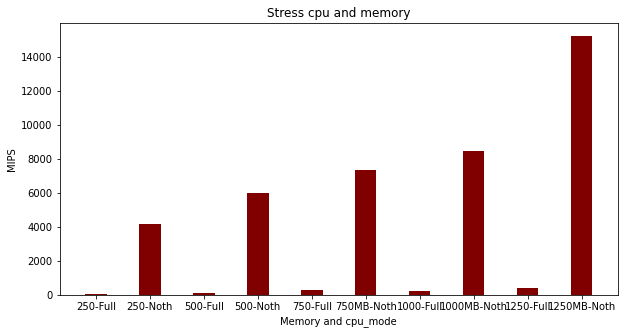

In [34]:
import numpy as np
import matplotlib.pyplot as plt
 
  
# creating the dataset
data = {'250-Full':mip_0, '250-Noth':mip_00, '500-Full':mip_1, '500-Noth':mip_11, '750-Full':mip_2, '750MB-Noth':mip_22,
        '1000-Full':mip_3, '1000MB-Noth':mip_33, '1250-Full': mip_4, '1250MB-Noth':mip_44}
courses = list(data.keys())
values = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(courses, values, color ='maroon',
        width = 0.4)
 
plt.xlabel("Memory and cpu_mode")
plt.ylabel("MIPS")
plt.title("Stress cpu and memory")
plt.savefig('ok', dpi=300)
plt.show()